
###*Pontificia Universidad Javeriana*

**Fecha**: 15 de mayo 2024

**Profesor**: John Corredor, PhD

**Materia**: Procesamiento de datos a gran escala.

**Objetivo**: Segundo Parcial - EDA y Aplicación de tecnicas de ML 

###**Integrante**: Santiago Rueda Pineda

###**ID Estudiante**: 1003634065

###**Integrante**: Brayan Steven Carrillo Mora

###**ID Estudiante**: 20487537


***Preguntas a responder con modelos ML***


1. Predicción de circunstancias segun caracteristicas del recién nacido:
¿Se puede predecir el tipo de nacimiento de un recien nacido de los municipios de Buga y Acaciasa través de la utilización de un modelo de clasificación?

2. Identificación de factores de riesgo:
¿Se puede predecir a través de un modelo de clasificación cuando un recien nacido hace parte de un nacimiento multiple?

In [0]:
#Instalamos unidecode para la eliminación de los acentos y caracteres especiales en la inforación al interior de los conjuntos de datos.
%pip install unidecode

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


In [0]:
import pyspark
from pyspark import SparkContext
from pyspark.sql import SparkSession
from pyspark.ml import Pipeline
from pyspark.sql import SQLContext
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import StringIndexer, VectorAssembler, QuantileDiscretizer
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
from sklearn.metrics import roc_curve, auc

import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt 
from matplotlib import rcParams
import pandas as pd

In [0]:
# Crear una sesión Spark
spark = SparkSession.builder.appName('MLenPyspark00').getOrCreate()

# Obtener el SparkContext
sc = spark.sparkContext

In [0]:
L_B = "https://www.datos.gov.co/resource/vskz-jk5x.csv" #link bases de datos nacimientos en Buga
L_A = "https://www.datos.gov.co/resource/7ifb-wrqs.csv" #link bases de datos nacimientos en Acacias


DF_B = pd.read_csv(L_B)
DF_A = pd.read_csv(L_A)


MLDFA = spark.createDataFrame(DF_A)

MLDFB = spark.createDataFrame(DF_B)

In [0]:
# Renombrar columnas de DF_A
MLDFA = MLDFA.withColumnRenamed("area_nacimiento", "departamento_nacimiento") \
           .withColumnRenamed("sitio_nacimiento", "rea_nacimiento") \
           .withColumnRenamed("nombre_instituci_n", "nombre_instituci_n_nacimiento") \
           .withColumnRenamed("sexo", "g_nero") \
           .withColumnRenamed("peso_gramos", "peso_nacimiento") \
           .withColumnRenamed("talla_cent_metros", "talla_nacimiento") \
           .withColumnRenamed("n_mero_consultas_prenatales", "n_mero_de_consultas_prenatales") \
           .withColumnRenamed("tipo_parto", "tipo_de_parto") \
           .withColumnRenamed("multiplicidad_embarazo", "multiplicidad_de_embarazo") \
           .withColumnRenamed("grupo_sanguineo", "grupo_sanguineo") \
           .withColumnRenamed("factor_rh", "factor_rh") \
           .withColumnRenamed("pertenencia_tnica", "cultura_pueblo_o_rasgos_f") \
           .withColumnRenamed("edad_madre", "edad_madre") \
           .withColumnRenamed("estado_conyugal_madre", "estado_conyugal_madre") \
           .withColumnRenamed("nivel_educativo_madre", "nivel_educativo_madre") \
           .withColumnRenamed("ultimo_a_o_aprobado_madre", "ultimo_a_o_aprobado_madre") \
           .withColumnRenamed("pa_s_residencia", "pa_s_residencia") \
           .withColumnRenamed("departamento_residencia", "departamento_residencia") \
           .withColumnRenamed("municipio_residencia", "municipio_residencia")

# Renombrar columnas de DF_B
MLDFB = MLDFB.withColumnRenamed("departamento_nacimiento", "departamento_nacimiento") \
           .withColumnRenamed("rea_nacimiento", "rea_nacimiento") \
           .withColumnRenamed("nombre_instituci_n_nacimiento", "nombre_instituci_n_nacimiento") \
           .withColumnRenamed("g_nero", "g_nero") \
           .withColumnRenamed("peso_nacimiento", "peso_nacimiento") \
           .withColumnRenamed("talla_nacimiento", "talla_nacimiento") \
           .withColumnRenamed("n_mero_de_consultas_prenatales", "n_mero_de_consultas_prenatales") \
           .withColumnRenamed("tipo_de_parto", "tipo_de_parto") \
           .withColumnRenamed("multiplicidad_de_embarazo", "multiplicidad_de_embarazo") \
           .withColumnRenamed("grupo_sanguineo", "grupo_sanguineo") \
           .withColumnRenamed("factor_rh", "factor_rh") \
           .withColumnRenamed("cultura_pueblo_o_rasgos_f", "cultura_pueblo_o_rasgos_f") \
           .withColumnRenamed("edad_madre", "edad_madre") \
           .withColumnRenamed("estado_conyugal_madre", "estado_conyugal_madre") \
           .withColumnRenamed("nivel_educativo_madre", "nivel_educativo_madre") \
           .withColumnRenamed("ultimo_a_o_aprobado_madre", "ultimo_a_o_aprobado_madre") \
           .withColumnRenamed("pa_s_residencia", "pa_s_residencia") \
           .withColumnRenamed("departamento_residencia", "departamento_residencia") \
           .withColumnRenamed("municipio_residencia", "municipio_residencia")

In [0]:
#Eliminacion de columnas diferentes 
# Obtener las columnas que son diferentes entre MLDA y MLDB
columns_in_MLDA_not_in_MLDB = set(MLDFA.columns) - set(MLDFB.columns)
columns_in_MLDB_not_in_MLDA = set(MLDFB.columns) - set(MLDFA.columns)

# Eliminar las columnas que son diferentes entre MLDA y MLDB
for col_name in columns_in_MLDA_not_in_MLDB:
    MLDFA = MLDFA.drop(col_name)

for col_name in columns_in_MLDB_not_in_MLDA:
    MLDFB = MLDFB.drop(col_name)

In [0]:
#Modificamos valores redudante 

from pyspark.sql.functions import lit

# Reemplazar todos los valores en la columna "rea_nacimiento" por "Acacias"
MLDFA = MLDFA.withColumn("rea_nacimiento", lit("acacias"))

# Reemplazar todos los valores en la columna "departamento_nacimiento" por "Meta"
MLDFA = MLDFA.withColumn("departamento_nacimiento", lit("Meta"))

#Reemplazar valores 
MLDFA = MLDFA.withColumn("rea_nacimiento", lit("acacias"))

MLDFB = MLDFB.withColumn("rea_nacimiento", lit("guadalajara de buga"))

# Mostrar el DataFrame resultante
MLDFA.display()

departamento_nacimiento,rea_nacimiento,nombre_instituci_n_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,cultura_pueblo_o_rasgos_f,edad_madre,barrio,edad_padre,nivel_educativo_padre
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,16,POPULAR,27,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,27,SAMAN,33,PROFESIONAL
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,28,SAMAN,34,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,22,LLANO VERDE,31,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,39,EL TREBOL,41,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,27,GUARATARA,25,MEDIA TÉCNICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,24,SIN INFORMACION,36,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,24,LA INDEPENDENCIA,41,SIN INFORMACIÓN
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,18,DORADO,18,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTÁNEO,SIMPLE,NO REGISTRA,NINGUNO DE LOS ANTERIORES,41,EL RETORNO,23,BÁSICA PRIMARIA


In [0]:
# Unir los dos DataFrames
MLDF = MLDFA.union(MLDFB)

# Mostrar el DataFrame resultante
MLDF.display()

departamento_nacimiento,rea_nacimiento,nombre_instituci_n_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,cultura_pueblo_o_rasgos_f,edad_madre,barrio,edad_padre,nivel_educativo_padre
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,16,POPULAR,27,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,27,SAMAN,33,PROFESIONAL
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,28,SAMAN,34,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,22,LLANO VERDE,31,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,39,EL TREBOL,41,BÁSICA SECUNDARIA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,27,GUARATARA,25,MEDIA TÉCNICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,24,SIN INFORMACION,36,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,24,LA INDEPENDENCIA,41,SIN INFORMACIÓN
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTÁNEO,SIMPLE,POSITIVO,NINGUNO DE LOS ANTERIORES,18,DORADO,18,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,500060016901 HOSPITAL MUNICIPAL DE ACACIAS ESE,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTÁNEO,SIMPLE,NO REGISTRA,NINGUNO DE LOS ANTERIORES,41,EL RETORNO,23,BÁSICA PRIMARIA


In [0]:
#Imprimimos la estructura del dataframe unificado
MLDF.printSchema()

root
 |-- departamento_nacimiento: string (nullable = true)
 |-- rea_nacimiento: string (nullable = false)
 |-- nombre_instituci_n_nacimiento: string (nullable = true)
 |-- g_nero: string (nullable = true)
 |-- peso_nacimiento: string (nullable = true)
 |-- talla_nacimiento: string (nullable = true)
 |-- fecha_nacimiento: string (nullable = true)
 |-- parto_atendido_por: string (nullable = true)
 |-- tiempo_de_gestaci_n: string (nullable = true)
 |-- n_mero_de_consultas_prenatales: string (nullable = true)
 |-- tipo_de_parto: string (nullable = true)
 |-- multiplicidad_de_embarazo: string (nullable = true)
 |-- factor_rh: string (nullable = true)
 |-- cultura_pueblo_o_rasgos_f: string (nullable = true)
 |-- edad_madre: long (nullable = true)
 |-- barrio: string (nullable = true)
 |-- edad_padre: long (nullable = true)
 |-- nivel_educativo_padre: string (nullable = true)



In [0]:
#Buscamos nulos

MLDF.select([count(when(isnan(c)|col(c).isNull(),c)).alias(c) for c in MLDF.columns]).display()

departamento_nacimiento,rea_nacimiento,nombre_instituci_n_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,cultura_pueblo_o_rasgos_f,edad_madre,barrio,edad_padre,nivel_educativo_padre
0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,134,0,1


In [0]:
#Observamos que la columna barrio es la que contiene la mayor cantidad de elementos nulo. 
#Debido a que barrio, no representa una variable significativa para el comportamiento de los datos, procedemos a eliminar la columna.
#Repetimos este procedimiento con variables como cultura_pueblo_o_rasgos_f y nombre_institucion_nacimiento debido a que igualmente no albergan información de interes.

MLDF = MLDF.drop("cultura_pueblo_o_rasgos_f")
MLDF = MLDF.drop("nombre_instituci_n_nacimiento")
MLDF = MLDF.drop('barrio')

MLDF.select([count(when(isnan(c)|col(c).isNull(),c)).alias(c) for c in MLDF.columns]).show()

+-----------------------+--------------+------+---------------+----------------+----------------+------------------+-------------------+------------------------------+-------------+-------------------------+---------+----------+----------+---------------------+
|departamento_nacimiento|rea_nacimiento|g_nero|peso_nacimiento|talla_nacimiento|fecha_nacimiento|parto_atendido_por|tiempo_de_gestaci_n|n_mero_de_consultas_prenatales|tipo_de_parto|multiplicidad_de_embarazo|factor_rh|edad_madre|edad_padre|nivel_educativo_padre|
+-----------------------+--------------+------+---------------+----------------+----------------+------------------+-------------------+------------------------------+-------------+-------------------------+---------+----------+----------+---------------------+
|                      0|             0|     0|              0|               0|               0|                 0|                  0|                             1|            0|                        0|       

In [0]:
#Observamos que solamente tenemos dos registros con datos nulos en las columnas nivel_educativo_padre y numero_de_consultas_prenatales, por lo cual, podemos eliminar dichos registros, sin causar mayor daño al conjuunto de datos.

MLDF = MLDF.na.drop()
MLDF.display()

departamento_nacimiento,rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre
Meta,acacias,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTÁNEO,SIMPLE,POSITIVO,16,27,BÁSICA SECUNDARIA
Meta,acacias,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTÁNEO,SIMPLE,POSITIVO,27,33,PROFESIONAL
Meta,acacias,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,28,34,BÁSICA SECUNDARIA
Meta,acacias,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTÁNEO,SIMPLE,POSITIVO,22,31,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTÁNEO,SIMPLE,POSITIVO,39,41,BÁSICA SECUNDARIA
Meta,acacias,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTÁNEO,SIMPLE,POSITIVO,27,25,MEDIA TÉCNICA
Meta,acacias,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTÁNEO,SIMPLE,POSITIVO,24,36,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTÁNEO,SIMPLE,POSITIVO,24,41,SIN INFORMACIÓN
Meta,acacias,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTÁNEO,SIMPLE,POSITIVO,18,18,MEDIA ACADÉMICA O CLÁSICA
Meta,acacias,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTÁNEO,SIMPLE,NO REGISTRA,41,23,BÁSICA PRIMARIA


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
from unidecode import unidecode

# Crear una sesión de Spark
spark = SparkSession.builder \
    .appName("Remove Accents") \
    .getOrCreate()

# Convertir el DataFrame de PySpark a un DataFrame de Pandas
pandas_df = MLDF.toPandas()

# Definir una función para eliminar las tildes de una cadena
def remove_accents_str(s):
    return unidecode(s) if isinstance(s, str) else s

# Aplicar la función a cada celda del DataFrame de Pandas
pandas_df = pandas_df.applymap(remove_accents_str)

# Convertir el DataFrame de Pandas de vuelta a un DataFrame de PySpark
MLDF = spark.createDataFrame(pandas_df)

# Mostrar el DataFrame resultante
MLDF.display()

departamento_nacimiento,rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre
Meta,acacias,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTANEO,SIMPLE,POSITIVO,16,27,BASICA SECUNDARIA
Meta,acacias,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTANEO,SIMPLE,POSITIVO,27,33,PROFESIONAL
Meta,acacias,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,28,34,BASICA SECUNDARIA
Meta,acacias,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTANEO,SIMPLE,POSITIVO,22,31,MEDIA ACADEMICA O CLASICA
Meta,acacias,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTANEO,SIMPLE,POSITIVO,39,41,BASICA SECUNDARIA
Meta,acacias,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,27,25,MEDIA TECNICA
Meta,acacias,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTANEO,SIMPLE,POSITIVO,24,36,MEDIA ACADEMICA O CLASICA
Meta,acacias,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTANEO,SIMPLE,POSITIVO,24,41,SIN INFORMACION
Meta,acacias,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTANEO,SIMPLE,POSITIVO,18,18,MEDIA ACADEMICA O CLASICA
Meta,acacias,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTANEO,SIMPLE,NO REGISTRA,41,23,BASICA PRIMARIA


In [0]:
from pyspark.sql.types import IntegerType

# Convertir la columna 'tiempo_de_gestaci_n' a tipo entero
MLDF = MLDF.withColumn("tiempo_de_gestaci_n", MLDF["tiempo_de_gestaci_n"].cast(IntegerType()))

# Convertir la columna 'talla_nacimiento' a tipo entero
MLDF = MLDF.withColumn("talla_nacimiento", MLDF["talla_nacimiento"].cast(IntegerType()))

# Convertir la columna 'n_mero_de_consultas_prenatales' a tipo entero
MLDF = MLDF.withColumn("n_mero_de_consultas_prenatales", MLDF["n_mero_de_consultas_prenatales"].cast(IntegerType()))

# Convertir la columna 'peso_nacimiento' a tipo entero
MLDF = MLDF.withColumn("peso_nacimiento", MLDF["peso_nacimiento"].cast(IntegerType()))

# Crear una nueva columna 'factor_rh_binario' con valores binarios
MLDF = MLDF.withColumn("factor_rh_binario", when(MLDF["factor_rh"] == "positivo", 1).otherwise(0))

# Mostrar el DataFrame resultante
MLDF.display()

departamento_nacimiento,rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario
Meta,acacias,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTANEO,SIMPLE,POSITIVO,16,27,BASICA SECUNDARIA,0
Meta,acacias,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTANEO,SIMPLE,POSITIVO,27,33,PROFESIONAL,0
Meta,acacias,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,28,34,BASICA SECUNDARIA,0
Meta,acacias,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTANEO,SIMPLE,POSITIVO,22,31,MEDIA ACADEMICA O CLASICA,0
Meta,acacias,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTANEO,SIMPLE,POSITIVO,39,41,BASICA SECUNDARIA,0
Meta,acacias,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,27,25,MEDIA TECNICA,0
Meta,acacias,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTANEO,SIMPLE,POSITIVO,24,36,MEDIA ACADEMICA O CLASICA,0
Meta,acacias,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTANEO,SIMPLE,POSITIVO,24,41,SIN INFORMACION,0
Meta,acacias,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTANEO,SIMPLE,POSITIVO,18,18,MEDIA ACADEMICA O CLASICA,0
Meta,acacias,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTANEO,SIMPLE,NO REGISTRA,41,23,BASICA PRIMARIA,0


In [0]:
from pyspark.sql.functions import when #Importamos when para identificar condiciones al interiror del dataframe de PySpark
#Debido a que los dataframe inciales fueron unidos, algunos niveles de educación equivalentes aparecen bajo otra denominación, por lo cual procedemos a
#Reemplazar "media academica" por "basica secundaria" en la columna nivel_educativo_padre

MLDF = MLDF.withColumn("nivel_educativo_padre",
                                   when(MLDF["nivel_educativo_padre"] == "MEDIA ACADEMICA O CLASICA",
                                        "BASICA SECUNDARIA")
                                   .otherwise(MLDF["nivel_educativo_padre"]))

# Mostrar el DataFrame resultante
MLDF.display()

departamento_nacimiento,rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,fecha_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario
Meta,acacias,MASCULINO,3220,50,2018-04-01T00:00:00.000,MEDICO,38,4,ESPONTANEO,SIMPLE,POSITIVO,16,27,BASICA SECUNDARIA,0
Meta,acacias,FEMENINO,3610,53,2018-04-01T00:00:00.000,MEDICO,41,7,ESPONTANEO,SIMPLE,POSITIVO,27,33,PROFESIONAL,0
Meta,acacias,MASCULINO,3300,51,2018-05-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,28,34,BASICA SECUNDARIA,0
Meta,acacias,FEMENINO,3070,52,2018-05-01T00:00:00.000,MEDICO,39,4,ESPONTANEO,SIMPLE,POSITIVO,22,31,BASICA SECUNDARIA,0
Meta,acacias,MASCULINO,4260,57,2018-07-01T00:00:00.000,MEDICO,38,9,ESPONTANEO,SIMPLE,POSITIVO,39,41,BASICA SECUNDARIA,0
Meta,acacias,MASCULINO,3540,50,2018-08-01T00:00:00.000,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,27,25,MEDIA TECNICA,0
Meta,acacias,FEMENINO,3330,53,2018-08-01T00:00:00.000,MEDICO,38,5,ESPONTANEO,SIMPLE,POSITIVO,24,36,BASICA SECUNDARIA,0
Meta,acacias,MASCULINO,4065,53,2018-08-01T00:00:00.000,MEDICO,40,6,ESPONTANEO,SIMPLE,POSITIVO,24,41,SIN INFORMACION,0
Meta,acacias,FEMENINO,2765,51,2018-10-01T00:00:00.000,MEDICO,37,5,ESPONTANEO,SIMPLE,POSITIVO,18,18,BASICA SECUNDARIA,0
Meta,acacias,FEMENINO,3660,52,2018-11-01T00:00:00.000,PARTERA,38,0,ESPONTANEO,SIMPLE,NO REGISTRA,41,23,BASICA PRIMARIA,0


In [0]:
# Eliminar la columna "fecha de nacimiento" y "departamento_nacimiento", ya que las fechas no tienen relevancia en el tratamiento de datos, y el departamento es inferible a través del municipio seleccionado
MLDF = MLDF.drop("fecha_nacimiento")
MLDF = MLDF.drop('departamento_nacimiento')

#Análisis exploratorio de datos

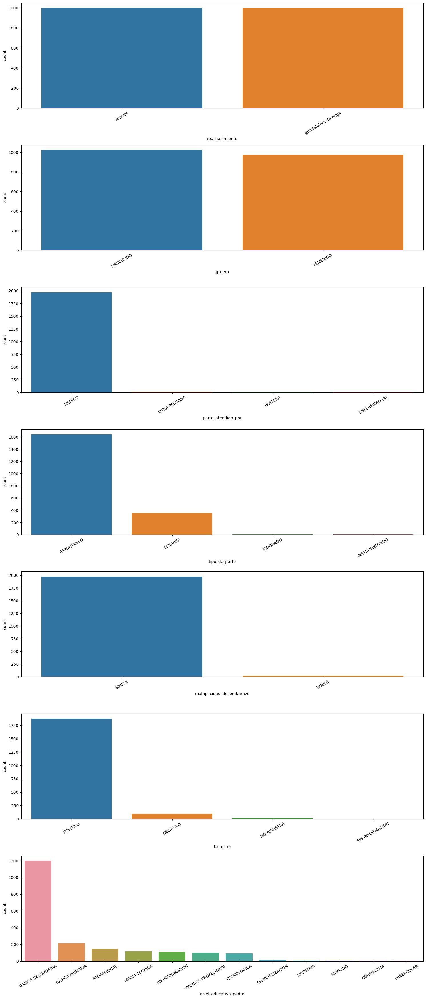

In [0]:


# Obtener una lista de columnas categóricas
columnas_categoricas = [columna for columna, dtype in MLDF.dtypes if dtype == "string"]

# Crear una figura y ejes para subparcelas
fig, axes = plt.subplots(len(columnas_categoricas), 1, figsize=(15, len(columnas_categoricas) * 5))

# Iterar sobre cada columna categórica y dibujar un gráfico de recuento
for columna, ax in zip(columnas_categoricas, axes.flatten()):
    # Contar los valores únicos en la columna y convertirlo en un DataFrame pandas para trazarlo
    count_df = MLDF.groupBy(columna).count().toPandas()
    # Ordenar el DataFrame por la columna de recuento en orden descendente
    count_df = count_df.sort_values(by="count", ascending=False)
    # Graficar un gráfico de barras de recuento
    sns.barplot(data=count_df, x=columna, y="count", ax=ax)
    # Ajustar la rotación del eje x si es necesario
    ax.tick_params(axis="x", rotation=30)

# Ajustar el espacio entre subparcelas
plt.tight_layout()
# Mostrar el gráfico
plt.show()

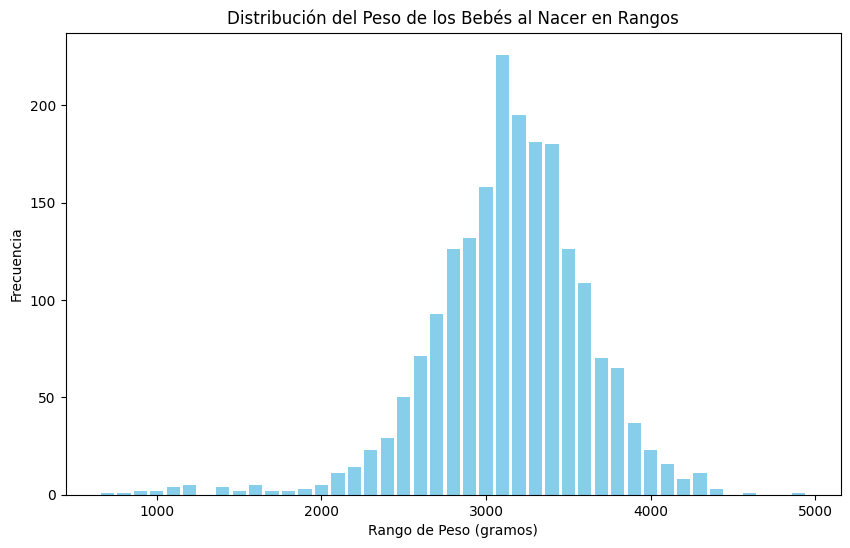

In [0]:
#Comportamiento peso

peso_min = 0
peso_max = 5000
intervalos = 100

# Crear los límites de los intervalos
bins = np.linspace(peso_min, peso_max, intervalos + 1)

# Agrupar los datos en los intervalos
MLDF = MLDF.withColumn("peso_nacimiento", MLDF["peso_nacimiento"].cast("double"))  # Convertir la columna a tipo double
MLDF = MLDF.withColumn("peso_rango", (MLDF["peso_nacimiento"] / intervalos).cast("int") * intervalos)  # Crear rango
conteo_peso_rango = MLDF.groupBy("peso_rango").count().orderBy("peso_rango")  # Contar el número de bebés en cada rango

# Convertir a Pandas para visualización
pandasDF_peso = conteo_peso_rango.toPandas()

# Calcular el ancho de cada barra
ancho_barra = intervalos * 0.8  # Usar 80% del intervalo como ancho

# Crear el gráfico de barras para visualizar la distribución del peso de los bebés en rangos
plt.figure(figsize=(10, 6))
plt.bar(pandasDF_peso["peso_rango"], pandasDF_peso["count"], color='skyblue', width=ancho_barra)

# Establecer el título y etiquetas de los ejes
plt.title('Distribución del Peso de los Bebés al Nacer en Rangos')
plt.xlabel('Rango de Peso (gramos)')
plt.ylabel('Frecuencia')

# Mostrar el gráfico
plt.show()

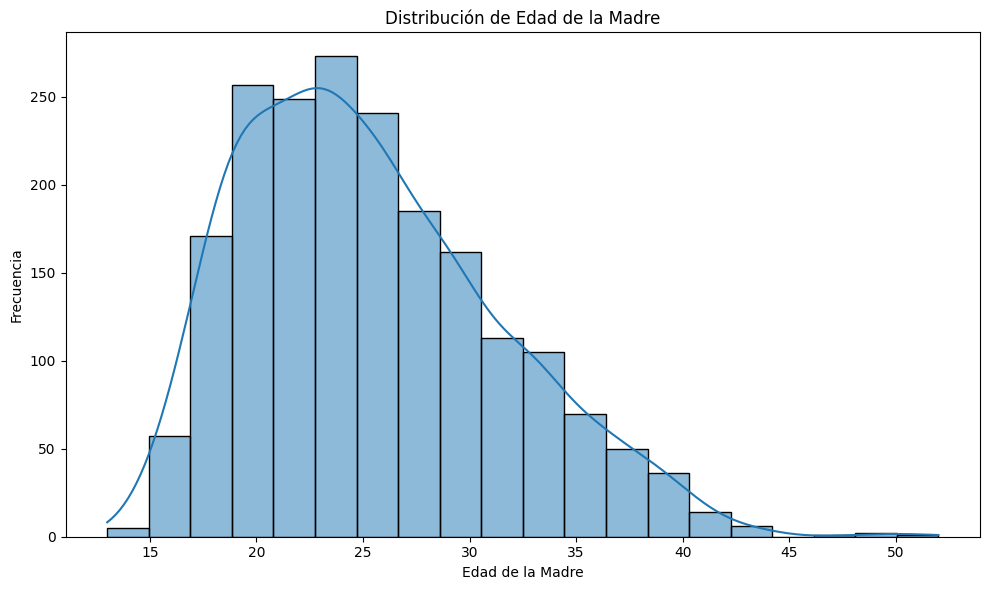

In [0]:
# Repetimos el procedimiento con la variable Edad Madre
# Convertir el DataFrame de PySpark a un DataFrame de Pandas para visualización
pandasDF = MLDF.select("edad_madre").toPandas()

# Crear la figura y los ejes
fig, axes = plt.subplots(1, 1, figsize=(10, 6))

# Graficar la distribución de la edad de la madre
sns.histplot(pandasDF["edad_madre"], bins=20, kde=True, ax=axes)

# Establecer el título y etiquetas de los ejes
axes.set_title("Distribución de Edad de la Madre")
axes.set_xlabel("Edad de la Madre")
axes.set_ylabel("Frecuencia")

# Ajustar el diseño para evitar superposiciones
plt.tight_layout()

# Mostrar el gráfico
plt.show()

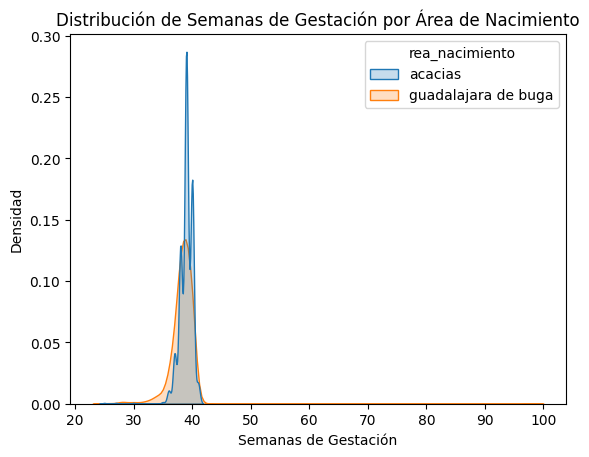

In [0]:
# Convertir el DataFrame de PySpark a un DataFrame de Pandas para visualización
pandasDF = MLDF.select("rea_nacimiento", "tiempo_de_gestaci_n").toPandas()

# Crear el gráfico de densidad
sns.kdeplot(data=pandasDF, x='tiempo_de_gestaci_n', hue='rea_nacimiento', fill=True)

# Establecer título y etiquetas de los ejes
plt.title("Distribución de Semanas de Gestación por Área de Nacimiento")
plt.xlabel("Semanas de Gestación")
plt.ylabel("Densidad")

# Mostrar el gráfico
plt.show()

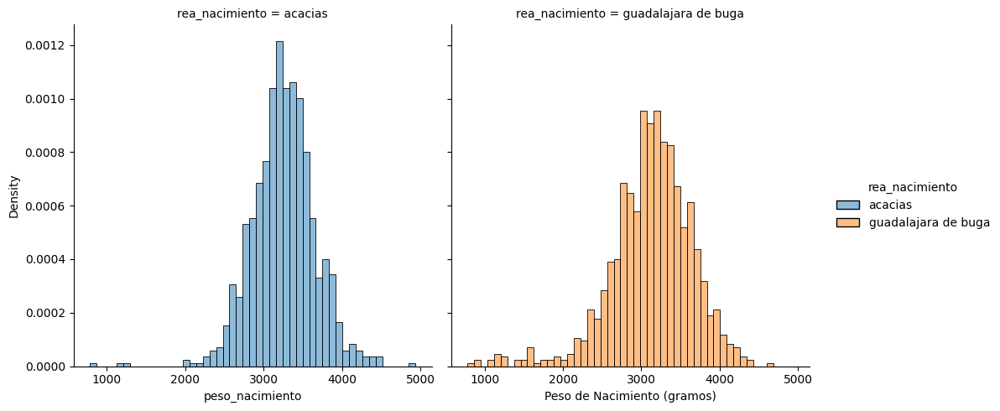

In [0]:
# Convertir el DataFrame de PySpark a un DataFrame de Pandas para visualización
pandasDF = MLDF.select("peso_nacimiento", "rea_nacimiento").toPandas()

# Crear el gráfico de densidad
sns.displot(data=pandasDF, x='peso_nacimiento', hue='rea_nacimiento', col='rea_nacimiento', stat='density', common_norm=False)

# Establecer título y etiquetas de los ejes
plt.xlabel("Peso de Nacimiento (gramos)")
plt.ylabel("Densidad")

# Mostrar el gráfico
plt.show()

In [0]:
from pyspark.sql.functions import when

# Agregar una nueva columna 'Alto_Riesgo'
MLDF = MLDF.withColumn('Alto_Riesgo', when((col('peso_nacimiento') > 4000) | (col('peso_nacimiento') < 2200) | (col('multiplicidad_de_embarazo') == 'DOBLE'), 1).otherwise(0))

# Mostrar las primeras 5 filas del DataFrame de Spark
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,MASCULINO,3220.0,50,MEDICO,38,4,ESPONTANEO,SIMPLE,POSITIVO,16,27,BASICA SECUNDARIA,0,3200,0
acacias,FEMENINO,3610.0,53,MEDICO,41,7,ESPONTANEO,SIMPLE,POSITIVO,27,33,PROFESIONAL,0,3600,0
acacias,MASCULINO,3300.0,51,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,28,34,BASICA SECUNDARIA,0,3300,0
acacias,FEMENINO,3070.0,52,MEDICO,39,4,ESPONTANEO,SIMPLE,POSITIVO,22,31,BASICA SECUNDARIA,0,3000,0
acacias,MASCULINO,4260.0,57,MEDICO,38,9,ESPONTANEO,SIMPLE,POSITIVO,39,41,BASICA SECUNDARIA,0,4200,1
acacias,MASCULINO,3540.0,50,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,27,25,MEDIA TECNICA,0,3500,0
acacias,FEMENINO,3330.0,53,MEDICO,38,5,ESPONTANEO,SIMPLE,POSITIVO,24,36,BASICA SECUNDARIA,0,3300,0
acacias,MASCULINO,4065.0,53,MEDICO,40,6,ESPONTANEO,SIMPLE,POSITIVO,24,41,SIN INFORMACION,0,4000,1
acacias,FEMENINO,2765.0,51,MEDICO,37,5,ESPONTANEO,SIMPLE,POSITIVO,18,18,BASICA SECUNDARIA,0,2700,0
acacias,FEMENINO,3660.0,52,PARTERA,38,0,ESPONTANEO,SIMPLE,NO REGISTRA,41,23,BASICA PRIMARIA,0,3600,0


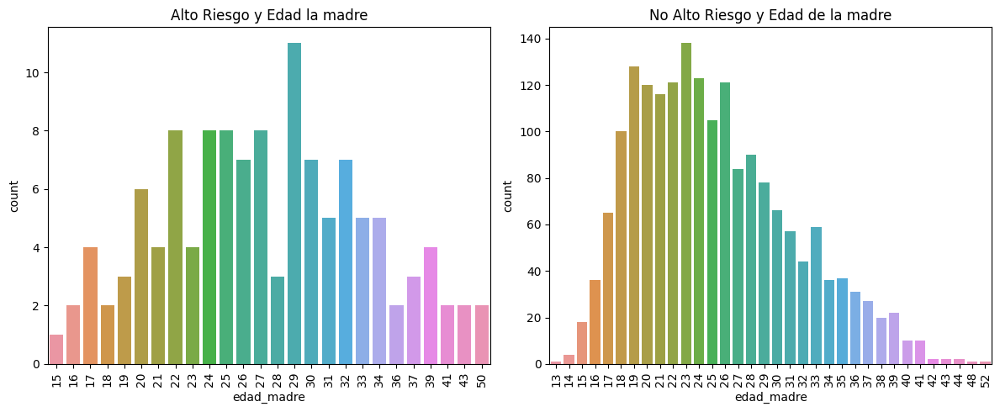

In [0]:
# Relación entre la edad del padre y el alto riesgo
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Subgráfico para alto riesgo
axes[0].set_title('Alto Riesgo y Edad la madre', fontsize=12)
sns.countplot(data=MLDF.filter(MLDF['Alto_Riesgo'] == 1).toPandas(), x='edad_madre', ax=axes[0])
axes[0].tick_params(axis='x', labelrotation=90)  # Rotar etiquetas del eje x

# Subgráfico para no alto riesgo
axes[1].set_title('No Alto Riesgo y Edad de la madre', fontsize=12)
sns.countplot(data=MLDF.filter(MLDF['Alto_Riesgo'] == 0).toPandas(), x='edad_madre', ax=axes[1])
axes[1].tick_params(axis='x', labelrotation=90)  # Rotar etiquetas del eje x

plt.tight_layout()  # Ajustar el diseño para evitar superposiciones
plt.show()


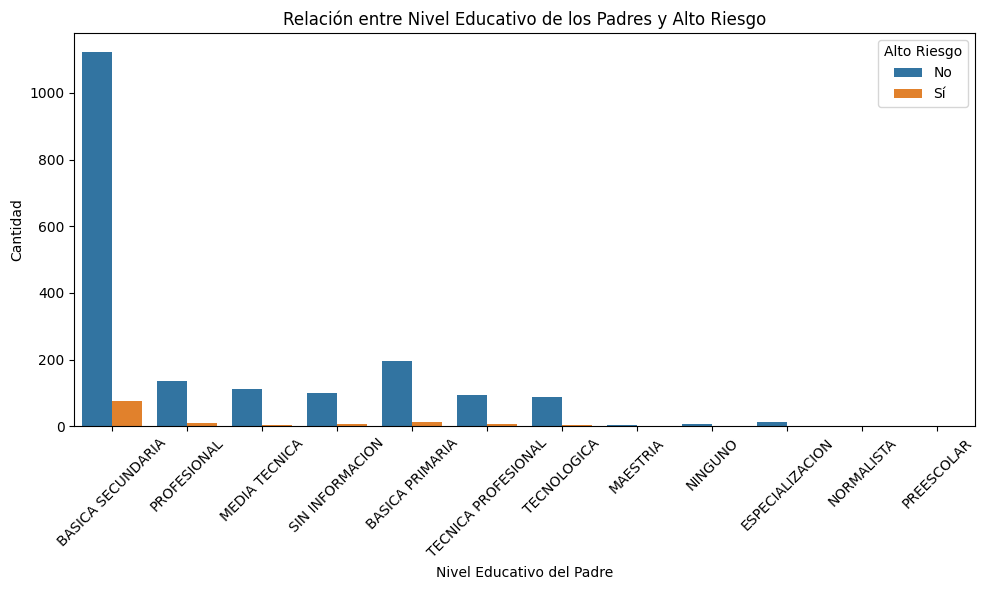

In [0]:
# Relación entre el nivel educativo de los padres y el alto riesgo
plt.figure(figsize=(10, 6))
sns.countplot(data=MLDF.toPandas(), x='nivel_educativo_padre', hue='Alto_Riesgo')

# Establecer título y etiquetas de los ejes
plt.title('Relación entre Nivel Educativo de los Padres y Alto Riesgo')
plt.xlabel('Nivel Educativo del Padre')
plt.ylabel('Cantidad')
plt.xticks(rotation=45)  # Rotar etiquetas del eje x para una mejor visualización

plt.legend(title='Alto Riesgo', labels=['No', 'Sí'])  # Agregar leyenda

plt.tight_layout()  # Ajustar el diseño para evitar superposiciones
plt.show()

In [0]:
from pyspark.sql.functions import when, col, mean
from unidecode import unidecode
from pyspark.sql.functions import udf
from pyspark.sql.types import StringType

# Función para eliminar tildes y convertir a mayúsculas
def remove_accents_upper(text):
    if text is not None:
        return unidecode(text).upper()
    return text

# Registrar la función como UDF
remove_accents_upper_udf = udf(remove_accents_upper, StringType())

# Aplicar la UDF para normalizar los valores en la columna
MLDF = MLDF.withColumn("nivel_educativo_padre", remove_accents_upper_udf(col("nivel_educativo_padre")))

# Crear el mapeo de valores educativos
education_mapping = {
    "NINGUNO": 0,
    "NORMALISTA": 1,
    "BASICA PRIMARIA": 2,
    "BASICA SECUNDARIA": 3,
    "MEDIA TECNICA": 4,
    "TECNICA PROFESIONAL": 5,
    "TECNOLOGICA": 6,
    "PROFESIONAL": 7,
    "ESPECIALIZACION": 8,
    "MAESTRIA": 9
}

# Aplicar el mapeo de valores educativos
for key, value in education_mapping.items():
    MLDF = MLDF.withColumn("nivel_educativo_padre", 
                           when(col("nivel_educativo_padre") == key, value)
                           .otherwise(col("nivel_educativo_padre")))

# Reemplazar "SIN INFORMACION" por nulos
MLDF = MLDF.withColumn("nivel_educativo_padre", 
                       when(col("nivel_educativo_padre") == "SIN INFORMACION", None)
                       .otherwise(col("nivel_educativo_padre")))

# Calcular el valor promedio de la columna "nivel_educativo_padre"
average_value = MLDF.select(mean(col("nivel_educativo_padre"))).first()[0]

# Rellenar los valores nulos con el valor promedio o 0 si es "NINGUNO"
MLDF = MLDF.withColumn("nivel_educativo_padre", 
                       when(col("nivel_educativo_padre").isNull(), average_value)
                       .otherwise(col("nivel_educativo_padre")))

# Mostrar el DataFrame resultante
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,MASCULINO,3220.0,50,MEDICO,38,4,ESPONTANEO,SIMPLE,POSITIVO,16,27,3,0,3200,0
acacias,FEMENINO,3610.0,53,MEDICO,41,7,ESPONTANEO,SIMPLE,POSITIVO,27,33,7,0,3600,0
acacias,MASCULINO,3300.0,51,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,28,34,3,0,3300,0
acacias,FEMENINO,3070.0,52,MEDICO,39,4,ESPONTANEO,SIMPLE,POSITIVO,22,31,3,0,3000,0
acacias,MASCULINO,4260.0,57,MEDICO,38,9,ESPONTANEO,SIMPLE,POSITIVO,39,41,3,0,4200,1
acacias,MASCULINO,3540.0,50,MEDICO,40,8,ESPONTANEO,SIMPLE,POSITIVO,27,25,4,0,3500,0
acacias,FEMENINO,3330.0,53,MEDICO,38,5,ESPONTANEO,SIMPLE,POSITIVO,24,36,3,0,3300,0
acacias,MASCULINO,4065.0,53,MEDICO,40,6,ESPONTANEO,SIMPLE,POSITIVO,24,41,3.5502645502645502,0,4000,1
acacias,FEMENINO,2765.0,51,MEDICO,37,5,ESPONTANEO,SIMPLE,POSITIVO,18,18,3,0,2700,0
acacias,FEMENINO,3660.0,52,PARTERA,38,0,ESPONTANEO,SIMPLE,NO REGISTRA,41,23,2,0,3600,0


In [0]:
#Multiplicidad de embarazo

# Convertir la columna 'multiplicidad_de_embarazo' en valores binarios
MLDF = MLDF.withColumn("multiplicidad_de_embarazo", 
                       when(col("multiplicidad_de_embarazo") == "SIMPLE", 0)
                       .when(col("multiplicidad_de_embarazo") == "DOBLE", 1)
                       .otherwise(None))

# Mostrar el DataFrame resultante
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,MASCULINO,3220.0,50,MEDICO,38,4,ESPONTANEO,0,POSITIVO,16,27,3,0,3200,0
acacias,FEMENINO,3610.0,53,MEDICO,41,7,ESPONTANEO,0,POSITIVO,27,33,7,0,3600,0
acacias,MASCULINO,3300.0,51,MEDICO,40,8,ESPONTANEO,0,POSITIVO,28,34,3,0,3300,0
acacias,FEMENINO,3070.0,52,MEDICO,39,4,ESPONTANEO,0,POSITIVO,22,31,3,0,3000,0
acacias,MASCULINO,4260.0,57,MEDICO,38,9,ESPONTANEO,0,POSITIVO,39,41,3,0,4200,1
acacias,MASCULINO,3540.0,50,MEDICO,40,8,ESPONTANEO,0,POSITIVO,27,25,4,0,3500,0
acacias,FEMENINO,3330.0,53,MEDICO,38,5,ESPONTANEO,0,POSITIVO,24,36,3,0,3300,0
acacias,MASCULINO,4065.0,53,MEDICO,40,6,ESPONTANEO,0,POSITIVO,24,41,3.5502645502645502,0,4000,1
acacias,FEMENINO,2765.0,51,MEDICO,37,5,ESPONTANEO,0,POSITIVO,18,18,3,0,2700,0
acacias,FEMENINO,3660.0,52,PARTERA,38,0,ESPONTANEO,0,NO REGISTRA,41,23,2,0,3600,0


In [0]:
# Convertir la columna 'g_nero' en valores numérico
MLDF = MLDF.withColumn('g_nero', 
                       when(MLDF['g_nero'] == 'FEMENINO', 0)
                       .when(MLDF['g_nero'] == 'MASCULINO', 1)
                       .otherwise(None))
# Mostrar el DataFrame resultante
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,1,3220.0,50,MEDICO,38,4,ESPONTANEO,0,POSITIVO,16,27,3,0,3200,0
acacias,0,3610.0,53,MEDICO,41,7,ESPONTANEO,0,POSITIVO,27,33,7,0,3600,0
acacias,1,3300.0,51,MEDICO,40,8,ESPONTANEO,0,POSITIVO,28,34,3,0,3300,0
acacias,0,3070.0,52,MEDICO,39,4,ESPONTANEO,0,POSITIVO,22,31,3,0,3000,0
acacias,1,4260.0,57,MEDICO,38,9,ESPONTANEO,0,POSITIVO,39,41,3,0,4200,1
acacias,1,3540.0,50,MEDICO,40,8,ESPONTANEO,0,POSITIVO,27,25,4,0,3500,0
acacias,0,3330.0,53,MEDICO,38,5,ESPONTANEO,0,POSITIVO,24,36,3,0,3300,0
acacias,1,4065.0,53,MEDICO,40,6,ESPONTANEO,0,POSITIVO,24,41,3.5502645502645502,0,4000,1
acacias,0,2765.0,51,MEDICO,37,5,ESPONTANEO,0,POSITIVO,18,18,3,0,2700,0
acacias,0,3660.0,52,PARTERA,38,0,ESPONTANEO,0,NO REGISTRA,41,23,2,0,3600,0


In [0]:
# Convertir la columna 'factor_rh' en valores numéricos
MLDF = MLDF.withColumn('factor_rh', 
                       when(MLDF['factor_rh'] == 'NEGATIVO', 0)
                       .when(MLDF['factor_rh'] == 'POSITIVO', 1)
                       .otherwise(None))
# Mostrar el DataFrame resultante
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,1,3220.0,50,MEDICO,38,4,ESPONTANEO,0,1,16,27,3,0,3200,0
acacias,0,3610.0,53,MEDICO,41,7,ESPONTANEO,0,1,27,33,7,0,3600,0
acacias,1,3300.0,51,MEDICO,40,8,ESPONTANEO,0,1,28,34,3,0,3300,0
acacias,0,3070.0,52,MEDICO,39,4,ESPONTANEO,0,1,22,31,3,0,3000,0
acacias,1,4260.0,57,MEDICO,38,9,ESPONTANEO,0,1,39,41,3,0,4200,1
acacias,1,3540.0,50,MEDICO,40,8,ESPONTANEO,0,1,27,25,4,0,3500,0
acacias,0,3330.0,53,MEDICO,38,5,ESPONTANEO,0,1,24,36,3,0,3300,0
acacias,1,4065.0,53,MEDICO,40,6,ESPONTANEO,0,1,24,41,3.5502645502645502,0,4000,1
acacias,0,2765.0,51,MEDICO,37,5,ESPONTANEO,0,1,18,18,3,0,2700,0
acacias,0,3660.0,52,PARTERA,38,0,ESPONTANEO,0,null,41,23,2,0,3600,0


In [0]:
# Debido a que solamente existen dos registros distitntos a espontaneo o cesarea, se pueden ignorar.
# Convertir la columna 'tipo_de_parto' en valores numéricos
MLDF = MLDF.withColumn('tipo_de_parto',
                       when(MLDF['tipo_de_parto'] == 'ESPONTANEO', 0)
                       .when(MLDF['tipo_de_parto'] == 'CESAREA', 1)
                       .otherwise(None))

# Mostrar el DataFrame resultante

# Reemplazar los valores nulos por 2 en la columna "tipo_de_parto"
MLDF = MLDF.withColumn("tipo_de_parto", when(col("tipo_de_parto").isNull(), 2).otherwise(col("tipo_de_parto")))

# Mostrar el DataFrame resultante
MLDF.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,parto_atendido_por,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,factor_rh,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,peso_rango,Alto_Riesgo
acacias,1,3220.0,50,MEDICO,38,4,0,0,1,16,27,3,0,3200,0
acacias,0,3610.0,53,MEDICO,41,7,0,0,1,27,33,7,0,3600,0
acacias,1,3300.0,51,MEDICO,40,8,0,0,1,28,34,3,0,3300,0
acacias,0,3070.0,52,MEDICO,39,4,0,0,1,22,31,3,0,3000,0
acacias,1,4260.0,57,MEDICO,38,9,0,0,1,39,41,3,0,4200,1
acacias,1,3540.0,50,MEDICO,40,8,0,0,1,27,25,4,0,3500,0
acacias,0,3330.0,53,MEDICO,38,5,0,0,1,24,36,3,0,3300,0
acacias,1,4065.0,53,MEDICO,40,6,0,0,1,24,41,3.5502645502645502,0,4000,1
acacias,0,2765.0,51,MEDICO,37,5,0,0,1,18,18,3,0,2700,0
acacias,0,3660.0,52,PARTERA,38,0,0,0,null,41,23,2,0,3600,0


In [0]:
# Convertir la columna 'rea_nacimiento' en valores numéricos
MLDF = MLDF.withColumn('rea_nacimiento',
                       when(MLDF['rea_nacimiento'] == 'acacias', 0)
                       .when(MLDF['rea_nacimiento'] == 'guadalajara de buga', 1)
                       .otherwise(None))

#Se realiza un nuevo filtro de columnas que contengan información de relevancia, por lo cual, las columnas parto_atendido_por, _peso_rango, factor_rh son eliminadas.
MLDF = MLDF.drop("parto_atendido_por")
MLDF = MLDF.drop("peso_rango")
MLDF = MLDF.drop("factor_rh")

In [0]:
#Buscamos nulos

MLDF.select([count(when(isnan(c)|col(c).isNull(),c)).alias(c) for c in MLDF.columns]).show()

+--------------+------+---------------+----------------+-------------------+------------------------------+-------------+-------------------------+----------+----------+---------------------+-----------------+-----------+
|rea_nacimiento|g_nero|peso_nacimiento|talla_nacimiento|tiempo_de_gestaci_n|n_mero_de_consultas_prenatales|tipo_de_parto|multiplicidad_de_embarazo|edad_madre|edad_padre|nivel_educativo_padre|factor_rh_binario|Alto_Riesgo|
+--------------+------+---------------+----------------+-------------------+------------------------------+-------------+-------------------------+----------+----------+---------------------+-----------------+-----------+
|             0|     0|              1|               1|                  1|                             1|            0|                        0|         0|         0|                    0|                0|          0|
+--------------+------+---------------+----------------+-------------------+------------------------------+-----

In [0]:
#Nuevamente son muy pocos los datos con filas nulas, por lo cual podemos eliminar los registros

MLDF = MLDF.na.drop()

MLDF.select([count(when(isnan(c)|col(c).isNull(),c)).alias(c) for c in MLDF.columns]).show()

+--------------+------+---------------+----------------+-------------------+------------------------------+-------------+-------------------------+----------+----------+---------------------+-----------------+-----------+
|rea_nacimiento|g_nero|peso_nacimiento|talla_nacimiento|tiempo_de_gestaci_n|n_mero_de_consultas_prenatales|tipo_de_parto|multiplicidad_de_embarazo|edad_madre|edad_padre|nivel_educativo_padre|factor_rh_binario|Alto_Riesgo|
+--------------+------+---------------+----------------+-------------------+------------------------------+-------------+-------------------------+----------+----------+---------------------+-----------------+-----------+
|             0|     0|              0|               0|                  0|                             0|            0|                        0|         0|         0|                    0|                0|          0|
+--------------+------+---------------+----------------+-------------------+------------------------------+-----

In [0]:
# Convertir la columna nivel_educativo_padre a tipo numérico
MLDF = MLDF.withColumn("nivel_educativo_padre", MLDF["nivel_educativo_padre"].cast("double"))

# Manejar valores nulos en la columna nivel_educativo_padre
MLDF = MLDF.withColumn("nivel_educativo_padre", when(col("nivel_educativo_padre").isNull(), 0).otherwise(col("nivel_educativo_padre")))

#Implementación de Machine Learning

##Primera pregunta

###Regresión logistica

In [0]:
#Creamos una copia de seguridad del dataframe ya depurado.
MLDF02 = MLDF

In [0]:
from pyspark.sql.functions import col, when

featureAssembler = VectorAssembler(inputCols=MLDF.drop('tipo_de_parto').columns, outputCol='features')
feature_vector = featureAssembler.transform(MLDF)
feature_vector.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,Alto_Riesgo,features
0,1,3220.0,50,38,4,0,0,16,27,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
0,0,3610.0,53,41,7,0,0,27,33,7.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
0,1,3300.0,51,40,8,0,0,28,34,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
0,0,3070.0,52,39,4,0,0,22,31,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
0,1,4260.0,57,38,9,0,0,39,41,3.0,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
0,1,3540.0,50,40,8,0,0,27,25,4.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
0,0,3330.0,53,38,5,0,0,24,36,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
0,1,4065.0,53,40,6,0,0,24,41,3.5502645502645502,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
0,0,2765.0,51,37,5,0,0,18,18,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
0,0,3660.0,52,38,0,0,0,41,23,2.0,0,0,"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
display(feature_vector.select("features"))

features
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
# Seleccionar características y la etiqueta de salida
MLDF = feature_vector.select(['features', 'tipo_de_parto'])

# Dividir los datos en conjuntos de entrenamiento y prueba
train, test = MLDF.randomSplit([0.8, 0.2])

In [0]:
# Importar la clase LogisticRegression desde pyspark.ml.classification
from pyspark.ml.classification import LogisticRegression

# Definir el modelo de regresión logística
logistic_reg = LogisticRegression(featuresCol="features", labelCol="tipo_de_parto")  # "tipo_de_parto" es nuestra columna label
# Entrenar el modelo utilizando los datos de entrenamiento
modelo_log_reg = logistic_reg.fit(train)

In [0]:
# Obtener los coeficientes del modelo
coeficientes = modelo_log_reg.coefficientMatrix

# Obtener el intercepto del modelo
intercepto = modelo_log_reg.interceptVector

# Imprimir los coeficientes y el intercepto
print("Coeficientes: ", coeficientes)
print("Intercepto: ", intercepto)

Coeficientes:  DenseMatrix([[-4.67357084e+00, -2.26390013e-01, -7.39640138e-04,
               2.81417532e-02,  4.12812294e-02,  1.81766834e-01,
               5.48133235e-01,  1.55566009e-02, -6.78079429e-02,
               2.04831374e-01,  0.00000000e+00, -1.05802718e+00],
             [ 7.16495799e+00, -1.65756966e-01, -6.26973332e-04,
               4.97834062e-02, -8.45750055e-02,  1.41394823e-01,
               2.11233534e+00,  7.60667248e-02, -7.39272308e-02,
               2.21851070e-01,  0.00000000e+00, -2.97159006e-01],
             [-2.49138715e+00,  3.92146979e-01,  1.36661347e-03,
              -7.79251594e-02,  4.32937761e-02, -3.23161657e-01,
              -2.66046857e+00, -9.16233257e-02,  1.41735174e-01,
              -4.26682444e-01,  0.00000000e+00,  1.35518618e+00]])
Intercepto:  [6.9291368544929135,-3.3925357689649394,-3.536601085527974]


In [0]:
# Realizar predicciones en el conjunto de prueba
predicciones = modelo_log_reg.transform(test)

# Seleccionar las columnas 'probability' y 'tipo_de_parto' de las predicciones
resultados = predicciones.select(['probability', 'tipo_de_parto'])

# Recolectar los resultados en una lista
resultadosColecc = resultados.collect()

# Crear una lista de tuplas con las probabilidades y las etiquetas reales invertidas
resultadosLista = [(float(i[0][0]), 1.0 - float(i[1])) for i in resultadosColecc]

# Convertir la lista en un RDD
puntuaciones = sc.parallelize(resultadosLista)


In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Calcular la precisión
Accuracy = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='accuracy').evaluate(predicciones)

# Calcular la precisión ponderada
Precision = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='weightedPrecision').evaluate(predicciones)

# Calcular el recall ponderado
Recall = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='weightedRecall').evaluate(predicciones)

# Imprimir las métricas
print(f"Accuracy: {Accuracy:.4f}")
print(f"Precision: {Precision:.4f}")
print(f"Recall: {Recall:.4f}")

Accuracy: 0.8622
Precision: 0.8480
Recall: 0.8622


In [0]:
from pyspark.ml.linalg import DenseVector

# Mapear el DataFrame original a un formato adecuado para MLlib
datos_entrada = MLDF.rdd.map(lambda x: (x["tipo_de_parto"], DenseVector(x["features"])))

# Crear un nuevo DataFrame con la estructura necesaria para el entrenamiento
dfML04 = spark.createDataFrame(datos_entrada, ["label", "features"])

# Mostrar las primeras 4 filas del nuevo DataFrame
dfML04.show(4)

+-----+--------------------+
|label|            features|
+-----+--------------------+
|    0|[0.0,1.0,3220.0,5...|
|    0|[0.0,0.0,3610.0,5...|
|    0|[0.0,1.0,3300.0,5...|
|    0|[0.0,0.0,3070.0,5...|
+-----+--------------------+
only showing top 4 rows



In [0]:
# Importar el StandardScaler
from pyspark.ml.feature import StandardScaler

# Instanciar el objeto StandardScaler
standardObjeto = StandardScaler(inputCol='features', outputCol='indStandard')

# Entrenar el objeto a escalar
escalado = standardObjeto.fit(dfML04)

# Transformar los datos (normalizar) según el escalado
escaladoDF = escalado.transform(dfML04)

# Inspeccionar el resultado
escaladoDF.show(2, truncate=False)

+-----+--------------------------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|label|features                                                |indStandard                                                                                                                                                         |
+-----+--------------------------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|0    |[0.0,1.0,3220.0,50.0,38.0,4.0,0.0,16.0,27.0,3.0,0.0,0.0]|[0.0,2.000151547123218,6.798979413879677,17.31821802348667,18.252568401323675,1.5266297605600327,0.0,2.627298477041101,1.177081620270542,2.1456390728837365,0.0,0.0]|
|0    |[0.0,0.0,3610.0,53.0,41.0,7.0,0.0,27.0,33.0,7.0,0.0,0.0]|[0.0,0.0,7.62245

###Arboles de decisión

In [0]:
#Creamos una copia de seguridad del dataframe ya depurado.
MLDF_L = MLDF02

In [0]:
from pyspark.sql.functions import col, when

featureAssembler = VectorAssembler(inputCols=MLDF_L.drop('tipo_de_parto').columns, outputCol='features')
feature_vector = featureAssembler.transform(MLDF_L)
feature_vector.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,Alto_Riesgo,features
0,1,3220.0,50,38,4,0,0,16,27,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
0,0,3610.0,53,41,7,0,0,27,33,7.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
0,1,3300.0,51,40,8,0,0,28,34,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
0,0,3070.0,52,39,4,0,0,22,31,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
0,1,4260.0,57,38,9,0,0,39,41,3.0,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
0,1,3540.0,50,40,8,0,0,27,25,4.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
0,0,3330.0,53,38,5,0,0,24,36,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
0,1,4065.0,53,40,6,0,0,24,41,3.5502645502645502,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
0,0,2765.0,51,37,5,0,0,18,18,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
0,0,3660.0,52,38,0,0,0,41,23,2.0,0,0,"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
display(feature_vector.select("features"))

features
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
# Seleccionar características y la etiqueta de salida
MLDF_L = feature_vector.select(['features', 'tipo_de_parto'])

# Dividir los datos en conjuntos de entrenamiento y prueba
train, test = MLDF_L.randomSplit([0.8, 0.2])

In [0]:
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Definir el modelo de árbol de decisiones
decision_tree = DecisionTreeClassifier(featuresCol="features", labelCol="tipo_de_parto")

# Entrenar el modelo utilizando los datos de entrenamiento
modelo_decision_tree = decision_tree.fit(train)

In [0]:
# Realizar predicciones en el conjunto de prueba
predicciones_decision_tree = modelo_decision_tree.transform(test)

# Calcular la precisión
accuracy_decision_tree = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='accuracy').evaluate(predicciones_decision_tree)

# Calcular la precisión ponderada
precision_decision_tree = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='weightedPrecision').evaluate(predicciones_decision_tree)

# Calcular el recall ponderado
recall_decision_tree = MulticlassClassificationEvaluator(labelCol='tipo_de_parto', metricName='weightedRecall').evaluate(predicciones_decision_tree)

In [0]:
# Imprimir las métricas
print(f"Accuracy (Decision Tree): {accuracy_decision_tree:.4f}")
print(f"Precision (Decision Tree): {precision_decision_tree:.4f}")
print(f"Recall (Decision Tree): {recall_decision_tree:.4f}")

Accuracy (Decision Tree): 0.8272
Precision (Decision Tree): 0.8076
Recall (Decision Tree): 0.8272


##Segunda pregunta

###Regresión logistica

In [0]:
#Creamos una copia de seguridad del dataframe ya depurado.
MLDF = MLDF02

In [0]:
from pyspark.sql.functions import col, when

featureAssembler = VectorAssembler(inputCols=MLDF.drop('multiplicidad_de_embarazo').columns, outputCol='features')
feature_vector = featureAssembler.transform(MLDF)
feature_vector.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,Alto_Riesgo,features
0,1,3220.0,50,38,4,0,0,16,27,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
0,0,3610.0,53,41,7,0,0,27,33,7.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
0,1,3300.0,51,40,8,0,0,28,34,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
0,0,3070.0,52,39,4,0,0,22,31,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
0,1,4260.0,57,38,9,0,0,39,41,3.0,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
0,1,3540.0,50,40,8,0,0,27,25,4.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
0,0,3330.0,53,38,5,0,0,24,36,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
0,1,4065.0,53,40,6,0,0,24,41,3.5502645502645502,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
0,0,2765.0,51,37,5,0,0,18,18,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
0,0,3660.0,52,38,0,0,0,41,23,2.0,0,0,"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
display(feature_vector.select("features"))

features
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
# Seleccionar características y la etiqueta de salida
MLDF = feature_vector.select(['features', 'multiplicidad_de_embarazo'])

# Dividir los datos en conjuntos de entrenamiento y prueba
train, test = MLDF.randomSplit([0.8, 0.2])

In [0]:
# Importar la clase LogisticRegression desde pyspark.ml.classification
from pyspark.ml.classification import LogisticRegression

# Definir el modelo de regresión logística
logistic_reg = LogisticRegression(featuresCol="features", labelCol="multiplicidad_de_embarazo")  # "multiplicidad_de_embarazo" es nuestra columna label
# Entrenar el modelo utilizando los datos de entrenamiento
modelo_log_reg = logistic_reg.fit(train)

In [0]:
# Obtener los coeficientes del modelo
coeficientes = modelo_log_reg.coefficientMatrix

# Obtener el intercepto del modelo
intercepto = modelo_log_reg.interceptVector

# Imprimir los coeficientes y el intercepto
print("Coeficientes: ", coeficientes)
print("Intercepto: ", intercepto)

Coeficientes:  DenseMatrix([[-8.97844322e-01, -5.44792687e-01, -2.47222771e-03,
               2.88459454e-01,  4.28957698e-02,  2.37725546e-01,
               2.22904853e+00,  1.63856013e-01, -1.14027908e-01,
               2.57986560e-02,  0.00000000e+00,  2.02801177e+01]])
Intercepto:  [-33.836507856144024]


In [0]:
# Realizar predicciones en el conjunto de prueba
predicciones = modelo_log_reg.transform(test)

# Seleccionar las columnas 'probability' y 'multiplicidad_de_embarazo' de las predicciones
resultados = predicciones.select(['probability', 'multiplicidad_de_embarazo'])

# Recolectar los resultados en una lista
resultadosColecc = resultados.collect()

# Crear una lista de tuplas con las probabilidades y las etiquetas reales invertidas
resultadosLista = [(float(i[0][0]), 1.0 - float(i[1])) for i in resultadosColecc]

# Convertir la lista en un RDD
puntuaciones = sc.parallelize(resultadosLista)

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

# Definir el evaluador de clasificación binaria para calcular el AUC-ROC
evaluador_binario = BinaryClassificationEvaluator(labelCol='multiplicidad_de_embarazo')

# Calcular el AUC-ROC
AUC = evaluador_binario.evaluate(predicciones)

# Calcular la precisión
Accuracy = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='accuracy').evaluate(predicciones)

# Calcular la precisión ponderada
Precision = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='weightedPrecision').evaluate(predicciones)

# Calcular el recall ponderado
Recall = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='weightedRecall').evaluate(predicciones)

# Imprimir las métricas
print(f"AUC-ROC: {AUC:.4f}")
print(f"Accuracy: {Accuracy:.4f}")
print(f"Precision: {Precision:.4f}")
print(f"Recall: {Recall:.4f}")

AUC-ROC: 0.9834
Accuracy: 0.9742
Precision: 0.9692
Recall: 0.9742


###Arboles de decisión

In [0]:
#Creamos una copia de seguridad del dataframe ya depurado.
MLDF_L = MLDF02

In [0]:
from pyspark.sql.functions import col, when

featureAssembler = VectorAssembler(inputCols=MLDF_L.drop('multiplicidad_de_embarazo').columns, outputCol='features')
feature_vector = featureAssembler.transform(MLDF_L)
feature_vector.display()

rea_nacimiento,g_nero,peso_nacimiento,talla_nacimiento,tiempo_de_gestaci_n,n_mero_de_consultas_prenatales,tipo_de_parto,multiplicidad_de_embarazo,edad_madre,edad_padre,nivel_educativo_padre,factor_rh_binario,Alto_Riesgo,features
0,1,3220.0,50,38,4,0,0,16,27,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
0,0,3610.0,53,41,7,0,0,27,33,7.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
0,1,3300.0,51,40,8,0,0,28,34,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
0,0,3070.0,52,39,4,0,0,22,31,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
0,1,4260.0,57,38,9,0,0,39,41,3.0,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
0,1,3540.0,50,40,8,0,0,27,25,4.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
0,0,3330.0,53,38,5,0,0,24,36,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
0,1,4065.0,53,40,6,0,0,24,41,3.5502645502645502,0,1,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
0,0,2765.0,51,37,5,0,0,18,18,3.0,0,0,"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
0,0,3660.0,52,38,0,0,0,41,23,2.0,0,0,"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
display(feature_vector.select("features"))

features
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3220.0, 50.0, 38.0, 4.0, 0.0, 16.0, 27.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3610.0, 53.0, 41.0, 7.0, 0.0, 27.0, 33.0, 7.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3300.0, 51.0, 40.0, 8.0, 0.0, 28.0, 34.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3070.0, 52.0, 39.0, 4.0, 0.0, 22.0, 31.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4260.0, 57.0, 38.0, 9.0, 0.0, 39.0, 41.0, 3.0, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 3540.0, 50.0, 40.0, 8.0, 0.0, 27.0, 25.0, 4.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 3330.0, 53.0, 38.0, 5.0, 0.0, 24.0, 36.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 1.0, 4065.0, 53.0, 40.0, 6.0, 0.0, 24.0, 41.0, 3.5502645502645502, 0.0, 1.0))"
"Map(vectorType -> dense, length -> 12, values -> List(0.0, 0.0, 2765.0, 51.0, 37.0, 5.0, 0.0, 18.0, 18.0, 3.0, 0.0, 0.0))"
"Map(vectorType -> sparse, length -> 12, indices -> List(2, 3, 4, 7, 8, 9), values -> List(3660.0, 52.0, 38.0, 41.0, 23.0, 2.0))"


In [0]:
# Seleccionar características y la etiqueta de salida
MLDF_L = feature_vector.select(['features', 'multiplicidad_de_embarazo'])

# Dividir los datos en conjuntos de entrenamiento y prueba
train, test = MLDF_L.randomSplit([0.8, 0.2])

In [0]:
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Definir el modelo de árbol de decisiones
decision_tree = DecisionTreeClassifier(featuresCol="features", labelCol="multiplicidad_de_embarazo")

# Entrenar el modelo utilizando los datos de entrenamiento
modelo_decision_tree = decision_tree.fit(train)

In [0]:
# Realizar predicciones en el conjunto de prueba
predicciones_decision_tree = modelo_decision_tree.transform(test)

# Calcular la precisión
accuracy_decision_tree = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='accuracy').evaluate(predicciones_decision_tree)

# Calcular la precisión ponderada
precision_decision_tree = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='weightedPrecision').evaluate(predicciones_decision_tree)

# Calcular el recall ponderado
recall_decision_tree = MulticlassClassificationEvaluator(labelCol='multiplicidad_de_embarazo', metricName='weightedRecall').evaluate(predicciones_decision_tree)

In [0]:
# Imprimir las métricas
print(f"Accuracy (Decision Tree): {accuracy_decision_tree:.4f}")
print(f"Precision (Decision Tree): {precision_decision_tree:.4f}")
print(f"Recall (Decision Tree): {recall_decision_tree:.4f}")

Accuracy (Decision Tree): 0.9920
Precision (Decision Tree): 0.9920
Recall (Decision Tree): 0.9920
